# 0 验证环境

In [1]:
import torch

print("Pytorch Version: ", torch.__version__)

if torch.cuda.is_available():
    print("CUDA Version: ", torch.version.cuda)
    print("Device Num: ", torch.cuda.device_count())
    print("Device Name: ", torch.cuda.get_device_name())

Pytorch Version:  1.12.1+cu116
CUDA Version:  11.6
Device Num:  1
Device Name:  NVIDIA GeForce RTX 4090


In [2]:
import tensorflow as tf
 
print("TensorFlow version:", tf.__version__)
 
# 检查TensorFlow是否配置为使用GPU
if tf.config.list_physical_devices('GPU'):
    print("TensorFlow is using GPU(s)")
else:
    print("TensorFlow is using CPU")

2024-12-02 19:22:49.912711: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-12-02 19:22:49.994291: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-12-02 19:22:50.453916: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


TensorFlow version: 2.12.0
TensorFlow is using GPU(s)


2024-12-02 19:22:51.448110: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-12-02 19:22:51.469064: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-12-02 19:22:51.469785: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.


# 1 模型推理

In [3]:
import os
import sys
sys.path.append(os.path.dirname(os.getcwd()))

import torch
import pytorch_lightning as pl
from torch_geometric.loader import DataLoader
from smart.datasets.scalable_dataset import MultiDataset
from smart.model import SMART
from smart.transforms import WaymoTargetBuilder
from smart.utils.config import load_config_act
from smart.utils.log import Logging

## 1.1 加载配置文件

In [4]:
CONFIG_PATH = "../configs/validation/validation_scalable.yaml"

config = load_config_act(CONFIG_PATH)

## 1.2 加载模型

In [5]:
CKPT_PATH = "../ckpt/20241021_1037/epoch=07-step=30440-val_loss=2.52.ckpt"

Predictor = SMART
logger = Logging().log(level='DEBUG')
model = Predictor(config.Model)
model.load_params_from_file(filename=CKPT_PATH, logger=logger)
model.eval()

2024-12-02 19:22:52,138-INFO-smart.py-Line:222-Message:==> Loading parameters from checkpoint ../ckpt/20241021_1037/epoch=07-step=30440-val_loss=2.52.ckpt to GPU
2024-12-02 19:22:55,917-INFO-smart.py-Line:231-Message:The number of disk ckpt keys: 818
2024-12-02 19:22:55,985-INFO-smart.py-Line:247-Message:Missing keys: []
2024-12-02 19:22:55,986-INFO-smart.py-Line:248-Message:The number of missing keys: 0
2024-12-02 19:22:55,986-INFO-smart.py-Line:249-Message:The number of unexpected keys: 0
2024-12-02 19:22:55,987-INFO-smart.py-Line:250-Message:==> Done (total keys 818)


SMART(
  (encoder): SMARTDecoder(
    (map_encoder): SMARTMapDecoder(
      (type_pt_emb): Embedding(17, 128)
      (side_pt_emb): Embedding(4, 128)
      (polygon_type_emb): Embedding(4, 128)
      (light_pl_emb): Embedding(4, 128)
      (r_pt2pt_emb): FourierEmbedding(
        (freqs): Embedding(3, 64)
        (mlps): ModuleList(
          (0): Sequential(
            (0): Linear(in_features=129, out_features=128, bias=True)
            (1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
            (2): ReLU(inplace=True)
            (3): Linear(in_features=128, out_features=128, bias=True)
          )
          (1): Sequential(
            (0): Linear(in_features=129, out_features=128, bias=True)
            (1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
            (2): ReLU(inplace=True)
            (3): Linear(in_features=128, out_features=128, bias=True)
          )
          (2): Sequential(
            (0): Linear(in_features=129, out_features=128, bias=Tru

## 1.3 加载数据

In [6]:
data_config = config.Dataset
val_dataset = {
    "scalable": MultiDataset,
}[data_config.dataset](root=data_config.root, split='val',
                        raw_dir=data_config.val_raw_dir,
                        processed_dir=data_config.val_processed_dir,
                        transform=WaymoTargetBuilder(config.Model.num_historical_steps, config.Model.decoder.num_future_steps))
dataloader = DataLoader(val_dataset, batch_size=data_config.batch_size, shuffle=False, num_workers=data_config.num_workers,
                        pin_memory=data_config.pin_memory, persistent_workers=True if data_config.num_workers > 0 else False)

2024-12-02 19:22:55,999-DEBUG-scalable_dataset.py-Line:38-Message:Starting loading dataset with MultiDataset
2024-12-02 19:22:56,113-DEBUG-scalable_dataset.py-Line:62-Message:The number of val dataset is 44097


In [7]:
# 通过scenario_idx来选择加载不同的场景
SCENAIO_IDX = 1

data_iter = iter(dataloader)
for i in range(SCENAIO_IDX):
    batch = next(data_iter)
print(batch.scenario_id[0])

1000a444aa94927d


## 1.4 调用模型进行推理预测

In [8]:
data = model.match_token_map(batch)
data = model.sample_pt_pred(data)
data['agent']['av_index'] += data['agent']['ptr'][:-1]
    
with torch.no_grad():
    pred = model.inference(data)

## 1.5 测试推理效率

In [16]:
data = model.match_token_map(batch)
data = model.sample_pt_pred(data)
data['agent']['av_index'] += data['agent']['ptr'][:-1]
with torch.no_grad():
    pred = model.inference(data, show_detail=True)

inference time per frame:  9.956ms


# 2 真实性评价

In [13]:
# 从batch中提取真实轨迹信息
log_info = {}
log_info['x'] = batch['agent']['position'][:, 11:, 0]
log_info['y'] = batch['agent']['position'][:, 11:, 1]
log_info['heading'] = batch['agent']['heading'][:, 11:]
log_info['length'] = batch['agent']['shape'][:, 11:, 0]
log_info['width'] = batch['agent']['shape'][:, 11:, 1]
log_info['valid'] = batch['agent']['valid_mask'][:, 11:]

# 从pred中提取仿真轨迹信息
sim_info = {}
sim_info['x'] = pred['pred_traj'][..., 0]
sim_info['y'] = pred['pred_traj'][..., 1]
sim_info['heading'] = pred['pred_head']
sim_info['length'] = batch['agent']['shape'][:, 11:, 0]
sim_info['width'] = batch['agent']['shape'][:, 11:, 1]
sim_info['valid'] = batch['agent']['valid_mask'][:, 11:]

In [14]:
from smart.metrics.real_metrics.custom_metrics import RealMetrics
from smart.metrics.real_metrics.real_features import compute_real_metric_features

real_metrics = RealMetrics()

# 添加回放真实数据
real_metrics.add_log_features(
    compute_real_metric_features(
        center_x = log_info['x'],
        center_y = log_info['y'],
        length = log_info['length'],
        width = log_info['width'],
        heading = log_info['heading'],
        valid = log_info['valid'],
    )
)

# 添加仿真数据
real_metrics.add_sim_features(
    compute_real_metric_features(
        center_x = sim_info['x'],
        center_y = sim_info['y'],
        length = sim_info['length'],
        width = sim_info['width'],
        heading = sim_info['heading'],
        valid = sim_info['valid'],
    )
)

2024-12-02 16:26:51.435594: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-12-02 16:26:51.438145: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-12-02 16:26:51.444916: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-12-02 16:26:51.446877: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:982] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-12-02 16:26:51.448027: I tensorflow/compile

JS(linear_accel) = 0.23439190326772133


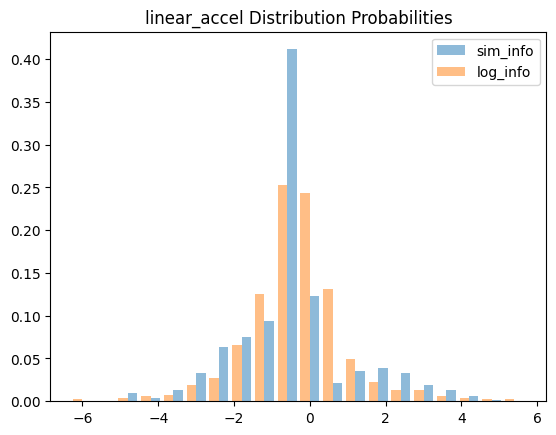

--------------------------------------------------

JS(linear_speed) = 0.2720938092537602


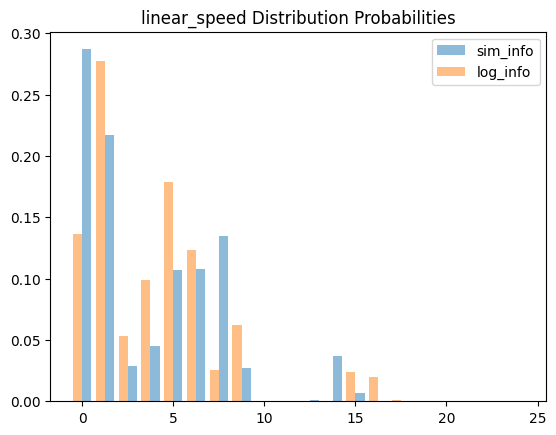

--------------------------------------------------

JS(yaw_speed) = 0.24139736862881783


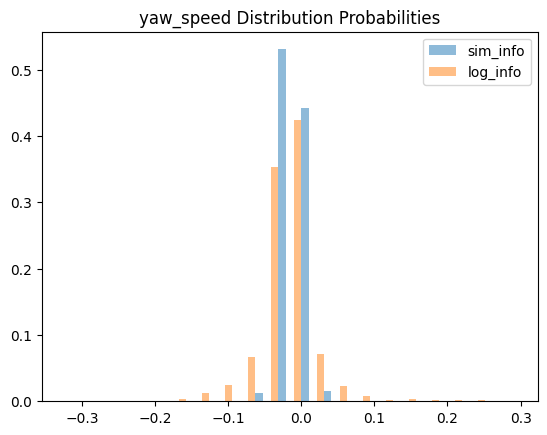

--------------------------------------------------

JS(yaw_accel) = 0.2674334754623201


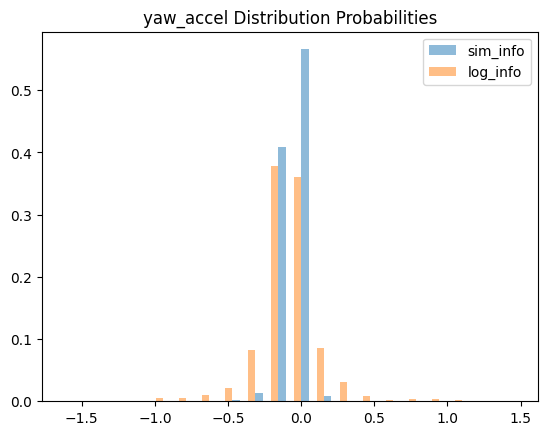

--------------------------------------------------

JS(relative_distance) = 0.1702307054107512


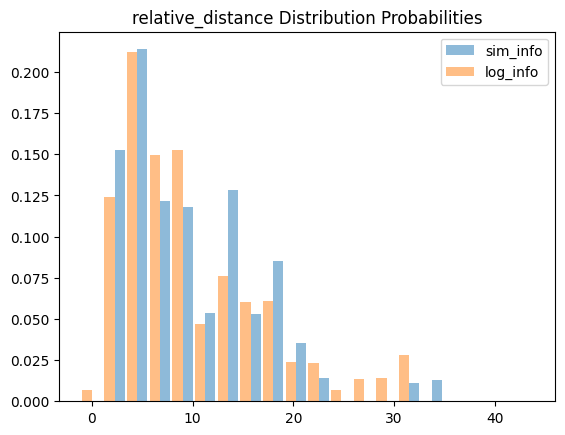

--------------------------------------------------

JS(relative_speed) = 0.20054079344518586


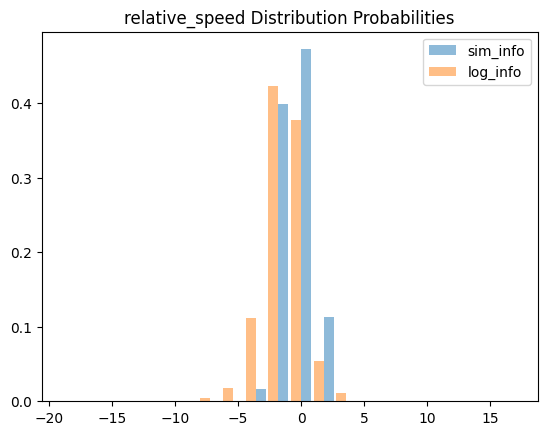

--------------------------------------------------

JS(relative_accel) = 0.30610259654262645


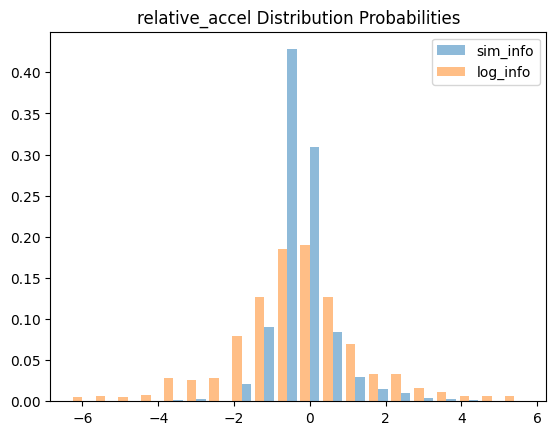

--------------------------------------------------

JS(ttc) = 0.10984255277271524


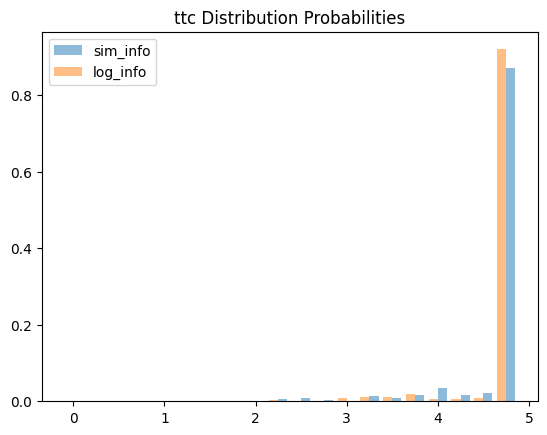

--------------------------------------------------



In [16]:
# 进行真实性指标估计（单场景）
real_metrics.compute_js_divergence(
    method='histogram',  #! kernel为核密度估计，histogram为直方图估计
    plot=True            #! 是否打印结果
)

# 3 可视化展示

## 3.1 显示每时刻车辆位置和朝向

In [65]:
from matplotlib import rc
rc('animation', html='jshtml')

import numpy as np
import matplotlib
matplotlib.use('TkAgg')
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.animation import FuncAnimation, PillowWriter

def plot_static_map(ax, batch):
    # 0:'DASH_SOLID_YELLOW', 1:'DASH_SOLID_WHITE', 2:'DASHED_WHITE', 3:'DASHED_YELLOW', 4:'DOUBLE_SOLID_YELLOW', 5:'DOUBLE_SOLID_WHITE', 6:'DOUBLE_DASH_YELLOW', 7:'DOUBLE_DASH_WHITE',
    # 8:'SOLID_YELLOW', 9:'SOLID_WHITE', 10:'SOLID_DASH_WHITE', 11:'SOLID_DASH_YELLOW', 12:'EDGE', 13:'NONE', 14:'UNKNOWN', 15:'CROSSWALK', 16:'CENTERLINE'
    _line_style = [['--', 2, 'yellow'], ['--', 2, 'grey'], ['--', 2, 'grey'], ['--', 2, 'yellow'], ['-', 2, 'yellow'], ['-', 2, 'grey'], ['--', 2, 'yellow'], ['--', 2, 'grey'],
                ['-', 2, 'yellow'], ['-', 2, 'grey'], ['--', 2, 'grey'], ['--', 2, 'yellow'], ['-', 3, 'black'], [], [], [':', 2, 'blue'], []]
    _center_colors = ['lightcoral', 'lightgreen', 'lightyellow', 'lightgray']

    # 准备数据
    polylines = []
    polyline_type = []
    for i in range(batch['map_polygon']['num_nodes']):
        point_idx = batch[('map_point', 'to', 'map_polygon')]['edge_index'][0, batch[('map_point', 'to', 'map_polygon')]['edge_index'][1] == i]
        polylines.append(torch.gather(batch['map_point']['position'][:, :2], dim=0, index=point_idx[..., None].repeat(1, 2)))
        polyline_type.append(batch['map_point']['type'][point_idx[0]])

    # 绘制每条地图线段
    for idx, (type, data) in enumerate(zip(polyline_type, polylines)):
        x = data[:, 0].numpy()
        y = data[:, 1].numpy()
        if (type == 13 or type == 14):
            continue
        elif (type == 16):
            ax.plot(x, y, marker='', linestyle='-', linewidth=2, color=_center_colors[batch['map_polygon']['light_type'][idx]], alpha=0.5)
        else:
            ax.plot(x, y, marker='', linestyle=_line_style[type][0], linewidth=_line_style[type][1], color=_line_style[type][2], alpha=0.8)

    ax.set_aspect('equal')
    ax.set_title(f"Scene <{batch['scenario_id'][0]}>")

def cal_polygon_contour(x, y, theta, width, length):
    left_front_x = x + 0.5 * length * np.cos(theta) - 0.5 * width * np.sin(theta)
    left_front_y = y + 0.5 * length * np.sin(theta) + 0.5 * width * np.cos(theta)
    left_front = np.column_stack((left_front_x, left_front_y))

    right_front_x = x + 0.5 * length * np.cos(theta) + 0.5 * width * np.sin(theta)
    right_front_y = y + 0.5 * length * np.sin(theta) - 0.5 * width * np.cos(theta)
    right_front = np.column_stack((right_front_x, right_front_y))

    right_back_x = x - 0.5 * length * np.cos(theta) + 0.5 * width * np.sin(theta)
    right_back_y = y - 0.5 * length * np.sin(theta) - 0.5 * width * np.cos(theta)
    right_back = np.column_stack((right_back_x, right_back_y))

    left_back_x = x - 0.5 * length * np.cos(theta) - 0.5 * width * np.sin(theta)
    left_back_y = y - 0.5 * length * np.sin(theta) + 0.5 * width * np.cos(theta)
    left_back = np.column_stack((left_back_x, left_back_y))

    polygon_contour = np.concatenate(
        (left_front[:, None, :], right_front[:, None, :], right_back[:, None, :], left_back[:, None, :]), axis=1)

    return polygon_contour

fig, ax_map = plt.subplots(figsize=(20, 20))
ax_agent = ax_map.twinx()

plot_static_map(ax_map, batch)

traj = torch.cat([batch['agent']['position'][:, :11, :2], pred['pred_traj']], dim=1)
head = torch.cat([batch['agent']['heading'][:, :11], pred['pred_head']], dim=1)

N, T, _ = traj.shape
agent_shape = batch['agent']['shape'][:, 10: 11, :].repeat(1, T, 1)
agent_traj_all = cal_polygon_contour(
    traj.view(-1, 2)[..., 0], 
    traj.view(-1, 2)[..., 1], 
    head.view(-1), 
    agent_shape.view(-1, 3)[..., 1], 
    agent_shape.view(-1, 3)[..., 0]
).reshape(N, T, 4, 2)

def update(frame):
    ax_agent.cla()
    ax_agent.axis('off')
    ax_agent.set_ylim(ax_map.get_ylim())
    polygons = []
    for agent_idx in range(agent_traj_all.shape[0]):
        polygon = patches.Polygon(agent_traj_all[agent_idx, frame], closed=True, fill='blue', edgecolor=None, alpha=0.9)  # fill=None 使其不填充
        ax_agent.add_patch(polygon)
        polygons.append(polygon)
    return polygons

ani = FuncAnimation(fig, update, frames=np.arange(T), blit=True)

# 将图像保存为gif
# ani.save(f"./outputs/{batch.scenario_id[0]}.gif", writer=PillowWriter(fps=10))

ani

## 3.2 显示车辆经过的轨迹

In [ ]:
from matplotlib import rc
rc('animation', html='jshtml')

import numpy as np
import matplotlib
matplotlib.use('TkAgg')
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.animation import FuncAnimation, PillowWriter

def plot_static_map(ax, batch):
    # 0:'DASH_SOLID_YELLOW', 1:'DASH_SOLID_WHITE', 2:'DASHED_WHITE', 3:'DASHED_YELLOW', 4:'DOUBLE_SOLID_YELLOW', 5:'DOUBLE_SOLID_WHITE', 6:'DOUBLE_DASH_YELLOW', 7:'DOUBLE_DASH_WHITE',
    # 8:'SOLID_YELLOW', 9:'SOLID_WHITE', 10:'SOLID_DASH_WHITE', 11:'SOLID_DASH_YELLOW', 12:'EDGE', 13:'NONE', 14:'UNKNOWN', 15:'CROSSWALK', 16:'CENTERLINE'
    _line_style = [['--', 2, 'yellow'], ['--', 2, 'grey'], ['--', 2, 'grey'], ['--', 2, 'yellow'], ['-', 2, 'yellow'], ['-', 2, 'grey'], ['--', 2, 'yellow'], ['--', 2, 'grey'],
                ['-', 2, 'yellow'], ['-', 2, 'grey'], ['--', 2, 'grey'], ['--', 2, 'yellow'], ['-', 3, 'black'], [], [], [':', 2, 'blue'], []]
    _center_colors = ['lightcoral', 'lightgreen', 'lightyellow', 'lightgray']

    # 准备数据
    polylines = []
    polyline_type = []
    for i in range(batch['map_polygon']['num_nodes']):
        point_idx = batch[('map_point', 'to', 'map_polygon')]['edge_index'][0, batch[('map_point', 'to', 'map_polygon')]['edge_index'][1] == i]
        polylines.append(torch.gather(batch['map_point']['position'][:, :2], dim=0, index=point_idx[..., None].repeat(1, 2)))
        polyline_type.append(batch['map_point']['type'][point_idx[0]])

    # 绘制每条地图线段
    for idx, (type, data) in enumerate(zip(polyline_type, polylines)):
        x = data[:, 0].numpy()
        y = data[:, 1].numpy()
        if (type == 13 or type == 14):
            continue
        elif (type == 16):
            ax.plot(x, y, marker='', linestyle='-', linewidth=2, color=_center_colors[batch['map_polygon']['light_type'][idx]], alpha=0.5)
        else:
            ax.plot(x, y, marker='', linestyle=_line_style[type][0], linewidth=_line_style[type][1], color=_line_style[type][2], alpha=0.8)

    ax.set_aspect('equal')
    ax.set_title(f"Scene <{batch['scenario_id'][0]}>")

def cal_polygon_contour(x, y, theta, width, length):
    left_front_x = x + 0.5 * length * np.cos(theta) - 0.5 * width * np.sin(theta)
    left_front_y = y + 0.5 * length * np.sin(theta) + 0.5 * width * np.cos(theta)
    left_front = np.column_stack((left_front_x, left_front_y))

    right_front_x = x + 0.5 * length * np.cos(theta) + 0.5 * width * np.sin(theta)
    right_front_y = y + 0.5 * length * np.sin(theta) - 0.5 * width * np.cos(theta)
    right_front = np.column_stack((right_front_x, right_front_y))

    right_back_x = x - 0.5 * length * np.cos(theta) + 0.5 * width * np.sin(theta)
    right_back_y = y - 0.5 * length * np.sin(theta) - 0.5 * width * np.cos(theta)
    right_back = np.column_stack((right_back_x, right_back_y))

    left_back_x = x - 0.5 * length * np.cos(theta) - 0.5 * width * np.sin(theta)
    left_back_y = y - 0.5 * length * np.sin(theta) + 0.5 * width * np.cos(theta)
    left_back = np.column_stack((left_back_x, left_back_y))

    polygon_contour = np.concatenate(
        (left_front[:, None, :], right_front[:, None, :], right_back[:, None, :], left_back[:, None, :]), axis=1)

    return polygon_contour

fig, ax_map = plt.subplots(figsize=(20, 20))
ax_agent = ax_map.twinx()

plot_static_map(ax_map, batch)

N, T, _ = pred['pred_traj'].shape
real_trajectory = pred['gt']
pred_trajectory = pred['pred_traj']

# 创建颜色表（每个物体使用不同颜色）
colors = plt.cm.viridis(torch.linspace(0, 1, N))  # 使用viridis颜色表

alpha_values = np.linspace(0.1, 0.8, 8) 
# 初始化真实轨迹和预测轨迹的绘制对象
# real_lines = [ax.plot([], [], 'o', color=colors[i], markersize=3, alpha=0.3)[0] for i in range(N)]  # 真实轨迹
pred_lines = [ax_map.plot([], [], 'o', color=colors[i], markersize=5, alpha=0.8)[0] for i in range(N)]  # 预测轨迹

# 更新函数，每一帧调用一次
def update(frame):
    for i in range(N):
        # 真实轨迹更新
        # real_lines[i].set_data(real_trajectory[i, frame, 0], real_trajectory[i, frame, 1])
        # 预测轨迹更新
        pred_lines[i].set_data(pred_trajectory[i, max(frame-8, 0):frame+1, 0], pred_trajectory[i, max(frame-8, 0): frame+1, 1])
    # return real_lines + pred_lines
    return pred_lines

# 创建动画
ani = FuncAnimation(fig, update, frames=T, interval=100, blit=True)

# 将图像保存为gif
# ani.save(f"./outputs/{batch.scenario_id[0]}.gif", writer=PillowWriter(fps=10))

ani

# 其他

## ONNX导出测试

In [ ]:
import torch
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.data import HeteroData
import torch_geometric

In [199]:
class SimpleHeteroModel(torch.nn.Module):
    def __init__(self):
        super(SimpleHeteroModel, self).__init__()
        self.conv1 = GCNConv(8, 16)
        self.conv2 = GCNConv(16, 32)

    def forward(self, data: HeteroData):
        x, edge_index = data['node_type'].x, data['node_type', 'to', 'node_type'].edge_index
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = self.conv2(x, edge_index)
        return x

In [164]:
def hetero_data_to_tensor_tuple(data: HeteroData):
    tensor_list = []
    for node_type, node_data in data.node_items():
        for key, tensor in node_data.items():
            tensor_list.append(tensor)
    for edge_type, edge_data in data.edge_items():
        for key, tensor in edge_data.items():
            tensor_list.append(tensor)
    return tuple(tensor_list)

In [165]:
class SimpleHeteroONNXWrapper(torch.nn.Module):
    def __init__(self, model, example_data):
        super(SimpleHeteroONNXWrapper, self).__init__()
        self.model = model
        self.example_data_structure = example_data

    def forward(self, *tensor_inputs):
        data = self.convert_to_hetero_data(tensor_inputs)
        return self.model(data)

    def convert_to_hetero_data(self, tensor_inputs):
        data = HeteroData()
        idx = 0
        for node_type, node_data in self.example_data_structure.node_items():
            for key in node_data.keys():
                setattr(data[node_type], key, tensor_inputs[idx])
                idx += 1
        for edge_type, edge_data in self.example_data_structure.edge_items():
            for key in edge_data.keys():
                setattr(data[edge_type], key, tensor_inputs[idx])
                idx += 1
        return data

In [166]:
example_data = HeteroData()
example_data['node_type'].x = torch.randn((10, 8))  # 10 nodes with 8 features each
example_data['node_type', 'to', 'node_type'].edge_index = torch.randint(0, 10, (2, 20))  # 20 edges

# 初始化并加载模型
simple_model = SimpleHeteroModel()
onnx_wrapper = SimpleHeteroONNXWrapper(simple_model, example_data)

# 获取示例输入
example_inputs = hetero_data_to_tensor_tuple(example_data)

In [167]:
# 导出到 ONNX 格式
torch.onnx.export(
    onnx_wrapper,
    example_inputs,
    "simple_hetero_model.onnx",
    input_names=[f"input_{i}" for i in range(len(example_inputs))],
    output_names=["output"],
    dynamic_axes={f"input_{i}": {0: "batch_size"} for i in range(len(example_inputs))},
    opset_version=11,
    do_constant_folding=True
)

/home/yangyh408/anaconda3/envs/smart/lib/python3.8/site-packages/torch/onnx/symbolic_opset9.py:4137: UserWarning: Exporting aten::index operator with indices of type Byte. Only 1-D indices are supported. In any other case, this will produce an incorrect ONNX graph.
  warnings.warn(


In [184]:
import torch
import numpy as np
import onnxruntime

def set_seed(seed=42):
    torch.manual_seed(seed)
    np.random.seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

set_seed(42)

# 定义示例输入
example_data = HeteroData()
example_data['node_type'].x = torch.randn((10, 8))  # 10 nodes with 8 features each
example_data['node_type', 'to', 'node_type'].edge_index = torch.randint(0, 10, (2, 20))  # 20 edges
example_inputs = hetero_data_to_tensor_tuple(example_data)

# 导出模型到 ONNX
torch.onnx.export(
    onnx_wrapper,
    example_inputs,
    "simple_hetero_model.onnx",
    input_names=[f"input_{i}" for i in range(len(example_inputs))],
    output_names=["output"],
    # dynamic_axes={f"input_{i}": {0: "batch_size"} for i in range(len(example_inputs))},
    opset_version=11,
    do_constant_folding=True
)

# 设置种子后再计算 PyTorch 输出
set_seed(42)
onnx_wrapper.eval()
with torch.no_grad():
    pytorch_output = onnx_wrapper(*example_inputs)

# 创建 ONNX 运行时会话
session = onnxruntime.InferenceSession("simple_hetero_model.onnx")
# 准备 ONNX 输入字典
onnx_input_dict = {f"input_{i}": tensor.detach().cpu().numpy() for i, tensor in enumerate(example_inputs)}
# 进行推理
onnx_output = session.run(None, onnx_input_dict)

# 将 PyTorch 输出转换为 NumPy 数组
pytorch_output_np = pytorch_output.detach().cpu().numpy()

# 检查 ONNX 和 PyTorch 输出的一致性
if np.allclose(onnx_output[0], pytorch_output_np, rtol=1e-3, atol=1e-5):
    print("ONNX and PyTorch outputs are consistent!")
else:
    print("Outputs differ between ONNX and PyTorch.")



Outputs differ between ONNX and PyTorch.


In [185]:
# 设置种子后再计算 PyTorch 输出
set_seed(42)
onnx_wrapper.eval()
with torch.no_grad():
    pytorch_output = onnx_wrapper(*example_inputs)
pytorch_output

tensor([[ 5.9671e-03, -1.9189e-01, -6.9430e-02,  3.9924e-02, -3.6220e-01,
         -2.1811e-01,  4.5647e-02,  1.8320e-01, -5.4718e-01, -3.4505e-01,
         -5.4831e-02,  1.9662e-02,  3.4358e-01, -2.8479e-01, -4.1332e-01,
          6.6295e-02,  6.3223e-02, -6.4044e-02,  1.1502e-01, -3.1252e-01,
          1.6202e-01,  1.8319e-04,  2.8605e-01, -8.1646e-02,  1.5195e-01,
         -7.0474e-03,  7.0387e-02,  8.6505e-02, -2.0905e-01,  1.9084e-02,
         -3.8809e-01, -2.1900e-02],
        [ 3.8890e-02, -2.5185e-01, -7.5222e-03,  3.3121e-02, -5.6432e-01,
         -1.9489e-01,  9.1773e-02,  2.7449e-01, -7.3359e-01, -4.6020e-01,
         -1.4594e-02,  3.4651e-02,  4.8144e-01, -3.4890e-01, -5.6609e-01,
          1.0663e-01,  7.6585e-03, -2.1998e-02,  1.9337e-01, -4.2445e-01,
          1.5362e-01,  6.8759e-02,  3.2649e-01, -1.2942e-01,  2.1101e-01,
         -7.9258e-02,  1.3842e-02,  1.2967e-01, -2.3054e-01,  4.2308e-02,
         -5.8879e-01,  4.7110e-02],
        [ 3.6821e-01,  1.3224e-02,  1.63

In [198]:
# 创建 ONNX 运行时会话
session = onnxruntime.InferenceSession("simple_hetero_model.onnx")
# 准备 ONNX 输入字典
onnx_input_dict = {f"input_{i}": tensor.detach().cpu().numpy() for i, tensor in enumerate(example_inputs)}
# 进行推理
onnx_output = session.run(None, onnx_input_dict)
onnx_output

[array([[-1.35891259e+00,  5.36735356e-01, -6.13924086e-01,
          7.50556767e-01,  1.83346078e-01, -1.07995105e+00,
         -9.31967318e-01, -1.16492771e-01, -1.24236822e+00,
          3.25781107e-02, -2.62718409e-01,  3.10892224e-01,
         -7.04178810e-02, -5.20153120e-02, -1.48391291e-01,
         -1.98711112e-01, -1.21454105e-01, -2.99240232e-01,
          4.57712471e-01, -2.31490329e-01,  1.22253311e+00,
          1.42108306e-01,  5.70460021e-01, -8.04444849e-01,
         -1.72228441e-01,  2.76746958e-01,  1.36651039e+00,
          9.94035542e-01, -2.13111535e-01, -6.15865469e-01,
         -7.98087656e-01, -1.03146851e-01],
        [ 2.16662273e-01, -6.93499029e-01,  2.37550437e-01,
         -2.90292919e-01, -8.32642674e-01, -4.33061868e-01,
          7.78994784e-02,  9.73093361e-02, -6.21600449e-01,
         -4.54021901e-01,  5.19788042e-02,  2.37776831e-01,
          4.87441003e-01, -7.39624023e-01, -8.30098152e-01,
         -1.86424717e-01,  1.53111577e-01,  3.35395306e-

In [196]:
import onnx
model = onnx.load("simple_hetero_model.onnx")
print(onnx.helper.printable_graph(model.graph))

graph torch_jit (
  %input_0[FLOAT, 10x8]
  %input_1[INT64, 2x20]
) initializers (
  %model.conv1.bias[FLOAT, 16]
  %model.conv2.bias[FLOAT, 32]
  %onnx::ConstantOfShape_174[INT64, 1]
  %onnx::MatMul_175[FLOAT, 8x16]
  %onnx::Concat_176[INT64, 1]
  %onnx::Range_177[INT64, scalar]
  %onnx::Range_178[INT64, scalar]
  %onnx::MatMul_180[FLOAT, 16x32]
) {
  %onnx::ConstantOfShape_179 = Identity(%onnx::ConstantOfShape_174)
  %onnx::Gather_6 = Constant[value = <Scalar Tensor []>]()
  %onnx::Equal_7 = Gather[axis = 0](%input_1, %onnx::Gather_6)
  %onnx::Gather_8 = Constant[value = <Scalar Tensor []>]()
  %onnx::Equal_9 = Gather[axis = 0](%input_1, %onnx::Gather_8)
  %onnx::Not_10 = Equal(%onnx::Equal_7, %onnx::Equal_9)
  %onnx::NonZero_11 = Not(%onnx::Not_10)
  %onnx::Expand_12 = Constant[value = <Tensor>]()
  %onnx::Tile_13 = Constant[value = <Tensor>]()
  %onnx::Expand_15 = ConstantOfShape[value = <Tensor>](%onnx::ConstantOfShape_174)
  %onnx::Tile_16 = Expand(%onnx::Expand_12, %onnx::Expand

In [195]:
import onnx.numpy_helper as numpy_helper

for init in model.graph.initializer:
    param_array = numpy_helper.to_array(init)
    print(f"Name: {init.name}, Values: {param_array}")
    print("="*30)

Name: model.conv1.bias, Values: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
Name: model.conv2.bias, Values: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
Name: onnx::ConstantOfShape_174, Values: [2]
Name: onnx::MatMul_175, Values: [[ 0.08430463  0.07292747  0.13709778  0.18835723  0.15080178 -0.01098573
  -0.22651398  0.00750333  0.12228078 -0.44691044  0.07745296 -0.08511984
   0.41364604 -0.13348919  0.03048247  0.07327414]
 [-0.13658506 -0.15349644  0.11321563  0.19252414  0.27013606  0.0231474
   0.2099815   0.30341822 -0.33355838  0.2500075   0.29419243 -0.06044006
  -0.10235846  0.12096488  0.17421293 -0.43935627]
 [ 0.39175922 -0.25813073  0.2055468   0.3966567   0.4374563   0.06334358
   0.00453454  0.03228521  0.17409343 -0.45000595  0.02972579  0.48894006
   0.23552275 -0.35530734 -0.31420207 -0.01696336]
 [ 0.30040365 -0.16077352  0.08581626  0.10178638 -0.15815586  0.18620914
  -0.07273233  0.03997612 -0.29986674 -0

In [194]:
import torchvision.models as models
torch.set_printoptions(precision=8)
state_dict = onnx_wrapper.state_dict()
for name, param in state_dict.items():
    print(f"Parameter Name: {name}")
    print(f"Shape: {param.shape}")
    print(f"Values: {param}")
    print("="*50)

Parameter Name: model.conv1.bias
Shape: torch.Size([16])
Values: tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])
Parameter Name: model.conv1.lin.weight
Shape: torch.Size([16, 8])
Values: tensor([[ 0.08430463, -0.13658506,  0.39175922,  0.30040365, -0.31057686,
         -0.04074073, -0.04799688, -0.31336540],
        [ 0.07292747, -0.15349644, -0.25813073, -0.16077352, -0.17827427,
          0.47832000,  0.19178599,  0.49205661],
        [ 0.13709778,  0.11321563,  0.20554680,  0.08581626, -0.39238572,
         -0.29567677, -0.12113929,  0.00751662],
        [ 0.18835723,  0.19252414,  0.39665669,  0.10178638, -0.17064661,
         -0.37601316, -0.36620533, -0.29866874],
        [ 0.15080178,  0.27013606,  0.43745631, -0.15815586, -0.03944147,
         -0.14848173, -0.00182700,  0.16050071],
        [-0.01098573,  0.02314740,  0.06334358,  0.18620914, -0.15170068,
         -0.29814881,  0.11796230, -0.05920279],
        [-0.22651398,  0.20998150,  0.00453454, -0